# DBSCAN

In [1]:
import numpy as np
import sys
sys.path.append("..")
from function.real_data_function import loadData,showData,removenans, preprocessing, showDistribution, crossplot, plotResult, dbscan, dbscan_param
from function.function import subsample, plot_dimensionality_reduction, crossplot_result, plot_cluster_distribution


## Load Data

In [2]:
data_vp = np.loadtxt('../realData/P-wave_output_monte_carlo_correct.xyz')
data_vs = np.loadtxt('../realData/S-wave_output_correct.xyz')
mask = np.loadtxt('../realData/S-wave_mask.xyz')
data = loadData(data_vp,data_vs,mask)
data = subsample(data,3)

## Plot Input Data

Using function show_data() to draw each parameter of input data. 

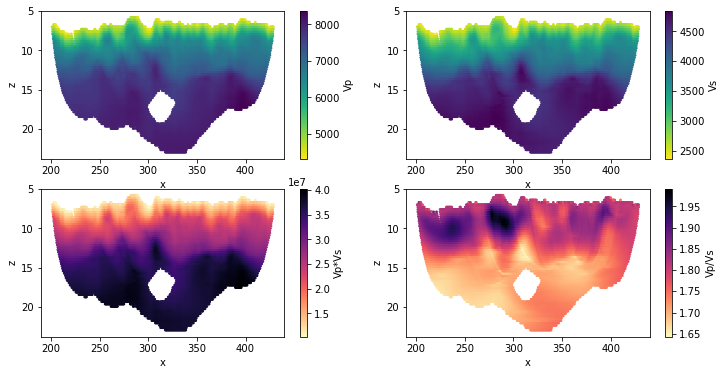

In [3]:
showData(data)

Using removenans() to remove points with nan values from array. 

- new_data is the original data saved in the form of np.array.

- data_noNan removes nan values from new_data. 

- nan_list is the list of nan values index.

In [4]:
data_noNan,nan_list = removenans(data)

Using showDistribution() to show the distribution of each parameter(except x and z)

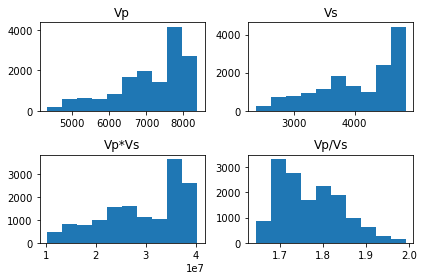

In [5]:
showDistribution(data)

Using crossplot to plot the cross-plot (scatter plot) of each pair of physical properties (other parameters and vp)

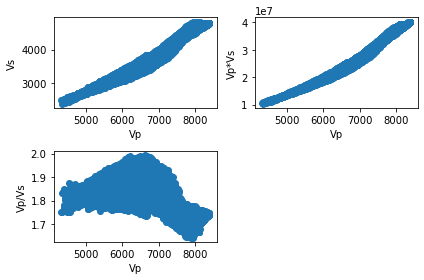

In [6]:
crossplot(data)

## Data Preprocessing

Using preprocessing() to make data standardized

In [7]:
# remove the mean
# divide by the variance

data_preprocessing = preprocessing(data_noNan) 


## Plot Data after Preprocessing

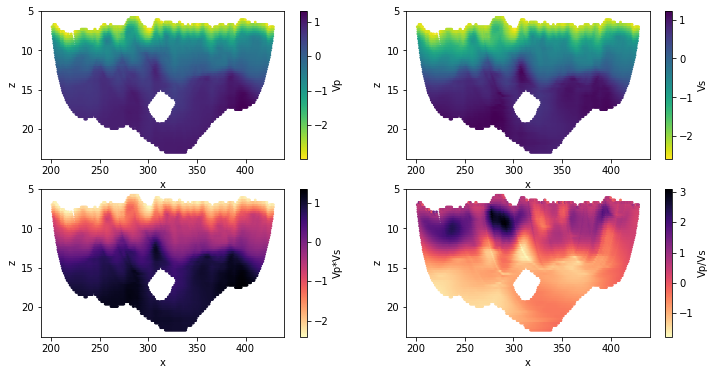

In [8]:
showData(data_preprocessing)

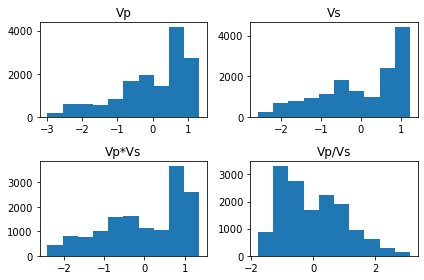

In [9]:
showDistribution(data_preprocessing)

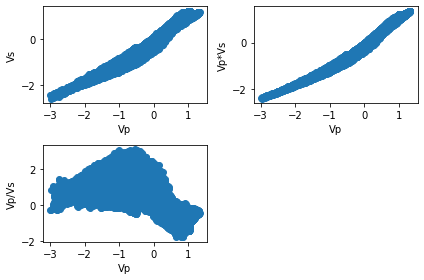

In [10]:
crossplot(data_preprocessing)

## DBSCAN

Using dbscan() to divide data in clusters.

- result_db is the result of DBSCAN and data_preprocessing is normalized data without nan values

Using plotResult() to show the result of clusters.

- data_noNan removes nan values from original data
- result_k is labels for data without nan values after DBSCAN

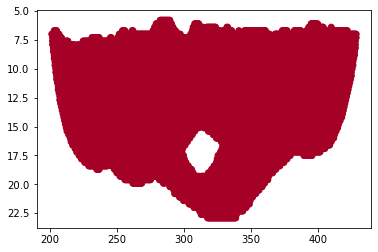

In [11]:
result_db = dbscan(data_preprocessing[:,:-2])
plotResult(data_noNan,result_db)

## Tuning Parameters

Using dbscan_param to find optimal parameters.

In [12]:
dbscan_param(data_preprocessing[:,:-2])

Running grid search over hyperparameters
CH score: 533.071265369995, eps: 0.2, min_sample_size: 50
CH score: 1988.8702466444402, eps: 0.2, min_sample_size: 70
CH score: 2745.6375048431905, eps: 0.2, min_sample_size: 80
CH score: 4856.502426620753, eps: 0.2, min_sample_size: 90
CH score: 8144.111819492143, eps: 0.2, min_sample_size: 100
CH score: 10883.148260960854, eps: 0.2, min_sample_size: 120
CH score: 16080.598737009677, eps: 0.2, min_sample_size: 200
CH score: 18060.231499304635, eps: 0.2, min_sample_size: 230
CH score: 22689.78315332247, eps: 0.2, min_sample_size: 360
CH score: 23052.84891104867, eps: 0.21000000000000002, min_sample_size: 400
CH score: 23442.703412276154, eps: 0.22000000000000003, min_sample_size: 430
CH score: 23833.063376463895, eps: 0.23000000000000004, min_sample_size: 460
CH score: 24185.740919158405, eps: 0.24000000000000005, min_sample_size: 500
CH score: 24569.46710560008, eps: 0.25000000000000006, min_sample_size: 540
CH score: 24891.32241858437, eps: 0.

Plotting result of best parameters.
dbscan() have two parameters.
- The first one is dataset.
- The second one is eps, which is the radius of the cluster.
- The third one is the minimum number of samples.

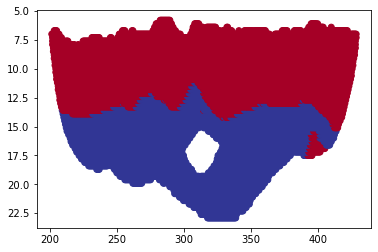

In [13]:
result_db = dbscan(data_preprocessing[:,:-2],eps=0.29, min_sample=700)
plotResult(data_noNan,result_db)

## Dimensionality Reduction

Using plot_dimensionality_reduction() to plot the cluster result after dimensionality reduction.

It has two parameters:

- The first one is dataset
- The second one is cluster result

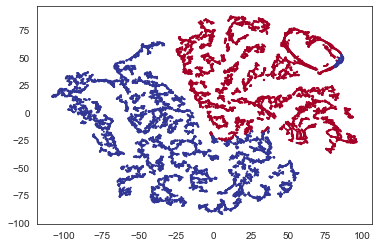

In [14]:
plot_dimensionality_reduction(data_preprocessing[:,:-2],result_db)

## Result Crossplot

crossplot_result has two parameters.
- The first one is dataset with no nan values.
- The second one is clustering result.

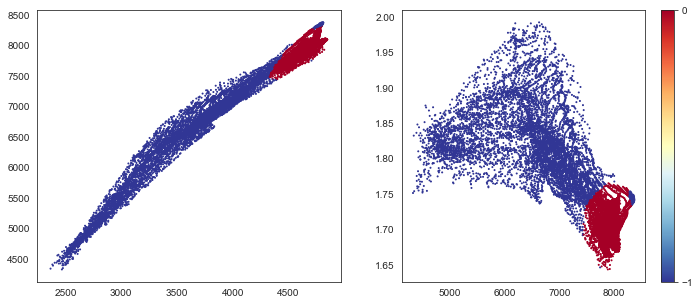

In [15]:
crossplot_result(data_noNan, result_db)

## Cluster Distribution

Using plot_cluster_distribution() to plot the distribution of clusters.

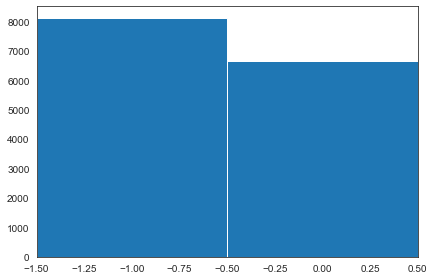

In [16]:
plot_cluster_distribution(result_db)